In [1]:
from fastai.tabular.all import *
from transfertab.utils import *
from transfertab.transfer import *
from transfertab.extract import *
from fastcore.xtras import *
from fastai.learner import *
import torch
import numpy as np
from fastai.interpret import *

In [2]:
import pandas as pd
df = pd.read_csv("../data/bank-additional-full.csv", delimiter=';')

In [3]:
import wandb
from fastai.callback.wandb import *

In [4]:
df.shape

(41188, 21)

In [5]:
41188 * 0.7

28831.6

In [6]:
dfA = df.iloc[0:28831]
dfB = df.iloc[28831:-1]

In [7]:
dfA.columns

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'emp.var.rate', 'cons.price.idx',
       'cons.conf.idx', 'euribor3m', 'nr.employed', 'y'],
      dtype='object')

In [8]:
contcols = ['age', 'duration', 'campaign', 'pdays',
       'previous', 'emp.var.rate', 'cons.price.idx',
       'cons.conf.idx', 'euribor3m', 'nr.employed']
catcols = ['job', 'marital', 'education', 'default', 'housing', 'loan','contact', 
	'month', 'day_of_week','poutcome']
target = 'y'

In [9]:
splitsA = RandomSplitter(valid_pct=0.2)(range_of(dfA))
toA = TabularPandas(dfA, procs=[Categorify, FillMissing, Normalize],
                   cat_names=catcols,
                   cont_names=contcols,
                   y_names=target,
                   splits=splitsA)
dlsA = toA.dataloaders(bs=512)
learnA = tabular_learner(dlsA, metrics=RocAucBinary)

In [10]:
splitsA = RandomSplitter(valid_pct=0.2)(range_of(dfA))
toA = TabularPandas(dfA, procs=[Categorify, FillMissing, Normalize],
                   cat_names=catcols,
                   cont_names=contcols,
                   y_names=target,
                   splits=splitsA)
dlsA = toA.dataloaders(bs=512)
rocaucbin = RocAucBinary()
learnA = tabular_learner(dlsA, metrics=[rocaucbin, accuracy])

In [11]:
wandb.init(
    project='Experiments', 
    save_code=True, 
    group='Exp4c v2', 
    job_type='pretrain', 
    tags=['base', 'bank', 'modelA'], 
    name='modelA training',
    notes="Training modelA from which we'll take embeddings",
    reinit=True,
    dir='/Users/manikyabardhan/Documents/github/transfertab/results/exp4c-v2',
    entity='transfertab'
)

In [12]:
cbs=[WandbCallback(log="all", dataset_name="bank-additional-full (first .7)", n_preds=128, seed=1), SaveModelCallback()]
learnA.fit_one_cycle(50, cbs=cbs)

epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


epoch,train_loss,valid_loss,roc_auc_score,accuracy,time
0,0.742446,0.676085,0.901483,0.733611,00:02
1,0.721670,0.685274,0.940751,0.802116,00:06
2,0.700482,0.660726,0.936917,0.869754,00:06
3,0.671983,0.615222,0.950835,0.888831,00:06
4,0.625605,0.543329,0.952714,0.899063,00:06
5,0.546002,0.425536,0.925603,0.936178,00:06
6,0.422753,0.281234,0.918322,0.945023,00:10
7,0.302040,0.196519,0.888314,0.947451,00:06
8,0.214999,0.146657,0.934127,0.947797,00:06
9,0.166288,0.127942,0.949302,0.947971,00:06


In [13]:
learnA.recorder.plot_loss()

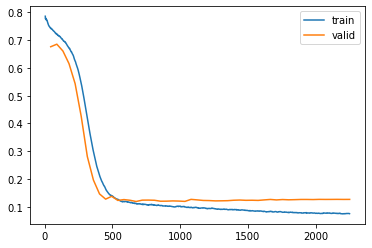

In [14]:
torch.save(learnA.model.state_dict(),"results/modelA_state_dict")

In [15]:
torch.save(learnA.model.state_dict(),"../results/modelA_state_dict")

In [16]:
torch.save(learnA.model.state_dict(),"../results/exp4c-v2/modelA_state_dict")

In [17]:
catdict = {col:list(learnA.dls.categorify.classes[col]) for col in catcols}

In [18]:
embeds = extractembeds(learnA.model, catdict, transfercats=catcols, allcats=catcols, path="learnA_extracts", kind="json")

In [19]:
wandb.finish()